In [1]:
# The script is used to integrate data between monkey cortex and mouse cortex data
suppressMessages(library(tidyverse))
suppressMessages(library(parallel))
suppressMessages(library(Seurat))
suppressMessages(library(SeuratData))
suppressMessages(library(patchwork))
suppressMessages(library(Matrix))
suppressMessages(library(viridis))
suppressMessages(library(cowplot))
suppressMessages(library(ggsci))
suppressMessages(library(pheatmap))
suppressMessages(library(RColorBrewer))
suppressMessages(library(reshape2))
suppressMessages(library(LSD))
suppressMessages(library(readxl))
suppressMessages(library(ggrepel))
suppressMessages(library(harmony))
suppressMessages(library(scrattch.hicat))
# suppressMessages(library(clusterProfiler))
# suppressMessages(library(GO.db))
# suppressMessages(library(biomaRt))
# suppressMessages(library(GSA))
suppressMessages(library(eulerr))
suppressMessages(library(enrichplot))
suppressMessages(library(clusterProfiler))
suppressMessages(library(org.Hs.eg.db))
suppressMessages(library(scales))
library(class)



options(future.globals.maxSize=100*1024^3) # 100G memory

# Plot each clusters
myHighlightDimPlot = function(seuratObj, highlightBy, size=1, alpha=1, showAllPoints=FALSE, ...) {
    umapTb = as_tibble(seuratObj@reductions$umap@cell.embeddings)
    if (!identical(rownames(seuratObj@reductions$umap@cell.embeddings), rownames(seuratObj@meta.data)))
        stop("Error: cell names not identical!")
    umapTb = cbind(umapTb, seuratObj@meta.data)
    highlightByClass = sort(unique(umapTb[[highlightBy]]))
    gpList = lapply(highlightByClass, function(cl) {
        subUmapTb = subset(umapTb, umapTb[[highlightBy]] == cl)
        if (showAllPoints) {
            gp = ggplot() + 
                geom_point(data=umapTb, aes(x=UMAP_1, y=UMAP_2), color="grey", shape=16, size=size, alpha=alpha) +
                geom_point(data=subUmapTb, aes(x=UMAP_1, y=UMAP_2), color="red", shape=16, size=size, alpha=alpha) +
                xlim(min(umapTb$UMAP_1), max(umapTb$UMAP_1)) +
                ylim(min(umapTb$UMAP_2), max(umapTb$UMAP_2)) +
                coord_fixed() +
                theme_void() 
        } else {
            gp = ggplot() + 
                geom_point(data=umapTb, aes(x=UMAP_1, y=UMAP_2), color="grey", shape=16, size=size, alpha=alpha) +
                geom_point(data=subUmapTb, aes(x=UMAP_1, y=UMAP_2), color="red", shape=16, size=size, alpha=alpha) +
                xlim(min(umapTb$UMAP_1), max(umapTb$UMAP_1)) +
                ylim(min(umapTb$UMAP_2), max(umapTb$UMAP_2)) +
                coord_fixed() +
                theme_void()
        }
        return(gp)
    })
    gpAll = plot_grid(plotlist=gpList, labels=highlightByClass, ...)
    return(gpAll)
}

select_markers = function (norm.dat, cl, n.markers = 20, de.genes = NULL, ...) {
    if (is.null(de.genes)) {
        de.genes = de_stats_all_pairs(norm.dat, cl, ...)
    }
    pairs = names(de.genes)
    select.pairs = pairs
    de.markers = sapply(select.pairs, function(s) {
        tmp = de.genes[[s]]
        c(head(tmp$up.genes, n.markers), head(tmp$down.genes, 
            n.markers))
    }, simplify = F)
    markers = intersect(unlist(de.markers), row.names(norm.dat))
    return(list(markers = markers, de.genes = de.genes[select.pairs]))
}




In [2]:
outdir='/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3area_compare_240123/compare_to_nearby/data'
integrateSeurat=readRDS(paste0(outdir, "/4area_compare_seurat_ALL_down300.rds"))


integrateSeurat@meta.data[grep('Insular',(integrateSeurat@meta.data$merge_anno)),]$group='Insular'
integrateSeurat@meta.data[grep('Clastrum',(integrateSeurat@meta.data$merge_anno)),]$group='Claustrum'
integrateSeurat@meta.data[grep('Amygdala',(integrateSeurat@meta.data$merge_anno)),]$group='Amygdala'
integrateSeurat@meta.data[grep('Putamen',(integrateSeurat@meta.data$merge_anno)),]$group='Putamen'

table(integrateSeurat$group)



 Amygdala Claustrum   Insular   Putamen 
    11939     14400     13800     12556 

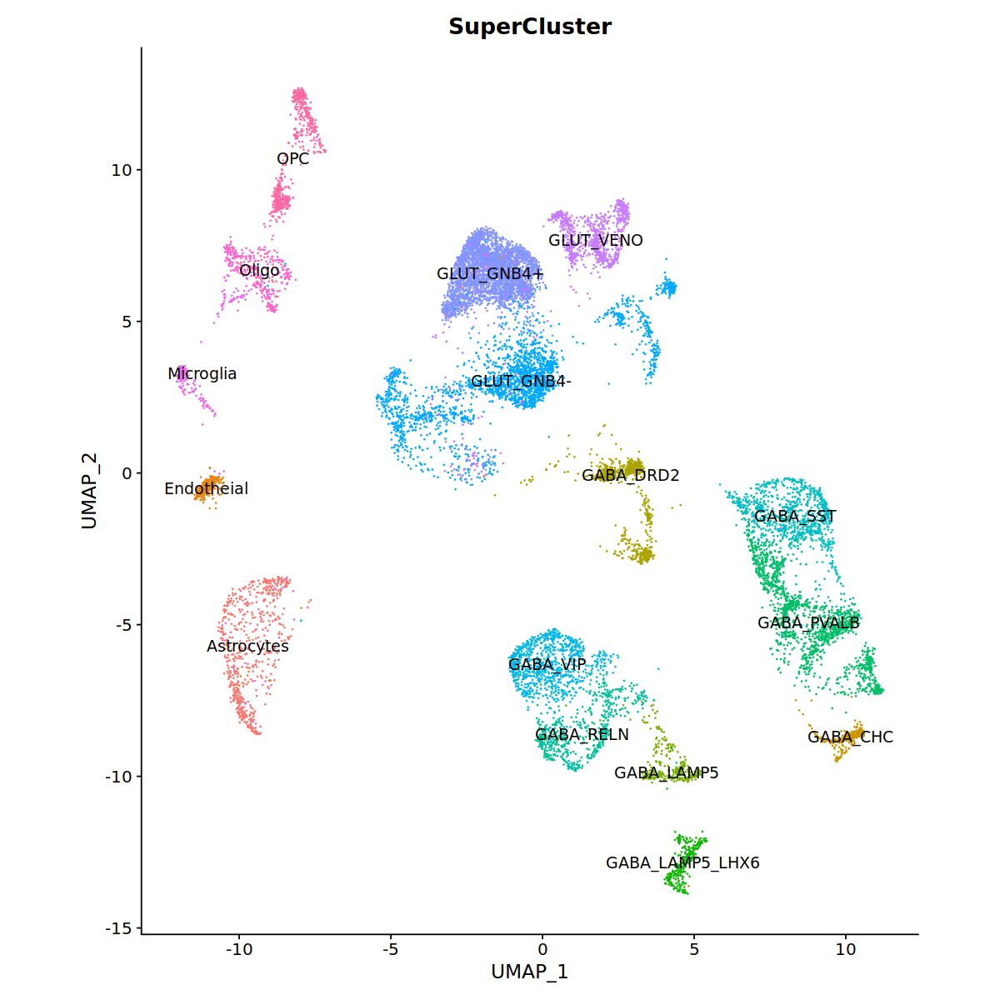

In [3]:
cla=subset(integrateSeurat,group=='Claustrum')
options(repr.plot.width=10, repr.plot.height=10)
DimPlot(cla, reduction="umap",label=T,group.by = 'SuperCluster',raster=FALSE)+coord_fixed()+NoLegend()


[1] TRUE

 Factor w/ 16 levels "Astrocytes","Endotheial",..: 11 11 13 11 11 11 11 11 11 11 ...
 - attr(*, "prob")= num [1:13800] 1 0.5 1 1 1 1 1 0.6 1 1 ...


`summarise()` has grouped output by 'clusterNameMod'. You can override using
the `.groups` argument.
Joining, by = "clusterNameMod"



 F  T 
 6 44 

[1] 46

[1] 42

Joining, by = "clusterNameMod"


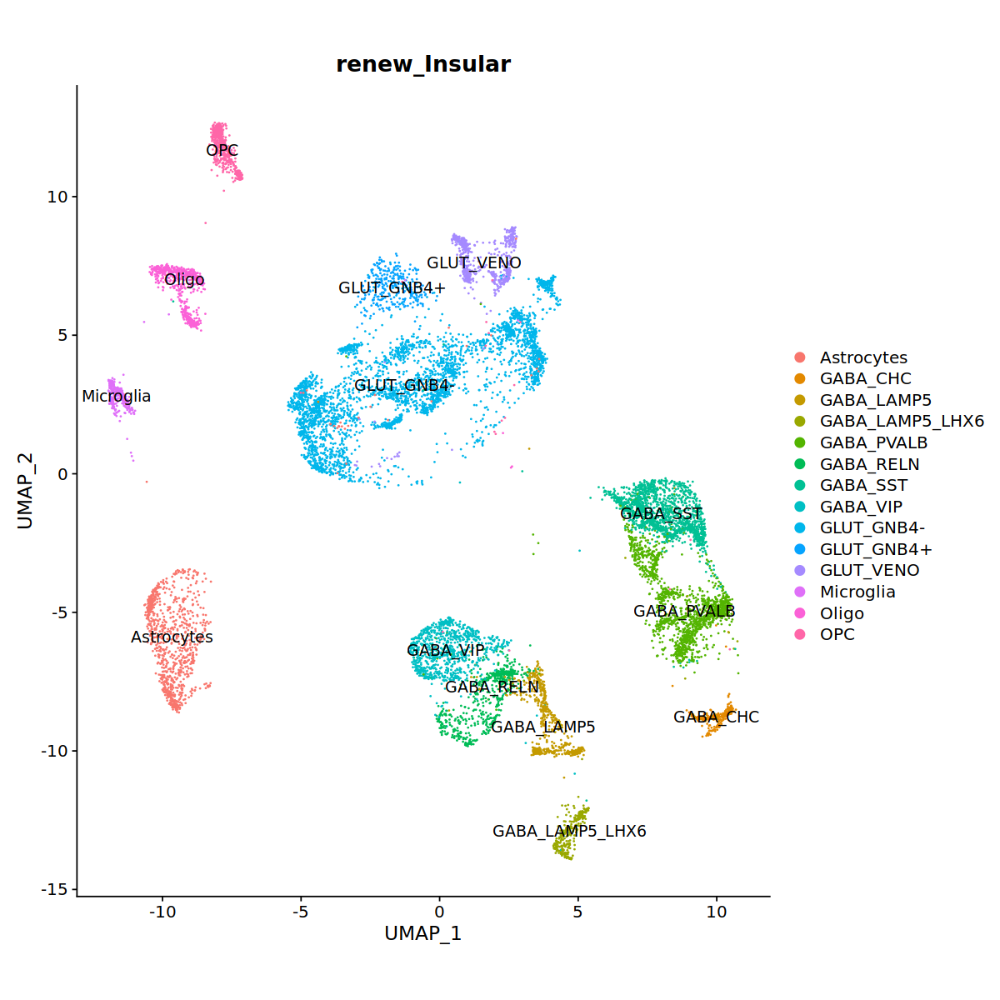

In [4]:
#knn算每个cluster附近细胞

sub=cla

# We try to infer the cell type by integrated result
trainUmapDf = as.data.frame(sub@reductions$umap@cell.embeddings)
identical(rownames(trainUmapDf), rownames(sub@meta.data))
trainCl = sub$SuperCluster

testUmapDf = as.data.frame(subset(integrateSeurat, group=="Insular")@reductions$umap@cell.embeddings)

umapPred = knn(trainUmapDf, testUmapDf, trainCl, k=10, prob=T)
str(umapPred)
integrateSpatialSeurat = subset(integrateSeurat, group=="Insular")
integrateSpatialSeurat$umapPredclusters = as.factor(as.character(umapPred))
integrateSpatialSeurat$umapPredclustersProb = attr(umapPred, "prob")

df_score=integrateSpatialSeurat@meta.data[,c('clusterNameMod','umapPredclusters','umapPredclustersProb')]
df_score=df_score[df_score$umapPredclustersProb >= 0.8,]

df_sum=df_score %>% group_by(clusterNameMod,umapPredclusters) %>% summarise(score=sum(umapPredclustersProb))

df_out1=df_sum %>% group_by(clusterNameMod) %>% top_n(n=1,wt=score)
colnames(df_out1)=c('clusterNameMod','umapPredclusters1','score1')

df_out2=df_sum %>% group_by(clusterNameMod) %>% top_n(n=2,wt=score)
df_out3=df_out2 %>% group_by(clusterNameMod) %>% top_n(n=-1,wt=score)
colnames(df_out3)=c('clusterNameMod','umapPredclusters2','score2')

df_out_sum=left_join(df_out1,df_out3)

df_out_sum$score3=df_out_sum$score1-df_out_sum$score2

df_out_sum$final_test='aba'
df_out_sum[df_out_sum$score3 <= df_out_sum$score2 *10,]$final_test='F'
df_out_sum[df_out_sum$score3==0,]$final_test='T'
df_out_sum[df_out_sum$score3 > df_out_sum$score2 *10,]$final_test='T'


table(df_out_sum$final_test)

#重新拾回来扔掉的非神经元
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
df_sub_F_fil_type=df_sub_F$clusterNameMod
for(i in df_sub_F_fil_type){
    name1=df_sub_F[df_sub_F$clusterNameMod==i,]$clusterNameMod
    name2=df_sub_F[df_sub_F$clusterNameMod==i,]$umapPredclusters1
    if(length(grep('GLUT',name1))==0 & length(grep('GLUT',name1))==0 & length(grep('GLUT',name2))==0 & length(grep('GLUT',name2))==0){
      df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
    }
}
#重新判断MSN 慎重！！！非必要不加
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
msn_n=df_sub_F$clusterNameMod[grep('MSN',df_sub_F$clusterNameMod)]
if(length(msn_n)>0){
    for(i in msn_n){
        if(df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1=='MSN' | 
          df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2=='MSN'){
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
        }
    }
}

#扔掉大类不符的细胞类型
df_out_sum$rename1='NoNeuron'
df_out_sum[grep('Excit',df_out_sum$clusterNameMod),]$rename1='EX'
df_out_sum[grep('Inhibit',df_out_sum$clusterNameMod),]$rename1='IN'

df_out_sum$rename2='NoNeuron'
df_out_sum[grep('EX',df_out_sum$umapPredclusters1),]$rename2='EX'
df_out_sum[grep('IN',df_out_sum$umapPredclusters1),]$rename2='IN'

df_out_sum[df_out_sum$rename1 != df_out_sum$rename2,]$final_test='F'
df_out_sum[df_out_sum$umapPredclusters1=='GABA_DRD2',]$final_test='F'
#扔掉打分过低的细胞类型
df_out_sum[df_out_sum$score1 <5,]$final_test='F'


df_out_sum1=df_out_sum[,c('clusterNameMod','umapPredclusters1','final_test')]
df_out_sum1=df_out_sum1[!duplicated(df_out_sum1),]
nrow(df_out_sum1)
df_out_sum1=df_out_sum1[df_out_sum1$final_test=='T',]
nrow(df_out_sum1)

sub_Insular=subset(integrateSeurat,group=='Insular')

sub_Insular=subset(sub_Insular,clusterNameMod %in% df_out_sum1$clusterNameMod)
df_compare=sub_Insular@meta.data[,c('clusterNameMod','group'),drop=F]
df_compare=left_join(df_compare,df_out_sum1)

sub_Insular=AddMetaData(sub_Insular,df_compare$umapPredclusters1,col.name = 'renew_Insular')

p1=DimPlot(sub_Insular, reduction="umap", group.by="renew_Insular", label=T)+coord_fixed()

p1

[1] TRUE

 Factor w/ 16 levels "Astrocytes","Endotheial",..: 5 7 11 1 11 16 11 11 7 1 ...
 - attr(*, "prob")= num [1:12556] 1 1 1 1 0.5 1 1 1 1 1 ...


`summarise()` has grouped output by 'clusterNameMod'. You can override using
the `.groups` argument.
Joining, by = "clusterNameMod"



F T 
9 5 

clusterNameMod,umapPredclusters1,score1,umapPredclusters2,score2,score3,final_test
<chr>,<fct>,<dbl>,<fct>,<dbl>,<dbl>,<chr>
Putamen_AST,Astrocytes,2108.309,GLUT_GNB4-,193.0000,1915.3091,F
Putamen_GABA_CHAT,GLUT_GNB4-,62.000,GLUT_GNB4+,21.4000,40.6000,F
Putamen_GABA_DRD1,GLUT_GNB4-,1438.845,GABA_DRD2,761.1000,677.7455,F
Putamen_GABA_DRD2,GLUT_GNB4-,1451.000,GABA_DRD2,763.3091,687.6909,F
Putamen_GABA_LAMP5,GABA_DRD2,199.000,GABA_LAMP5,73.6000,125.4000,F
Putamen_GABA_PVALB_KIT,GABA_VIP,433.600,GABA_PVALB,67.7000,365.9000,F
Putamen_GLUT,GLUT_GNB4-,4.900,GLUT_VENO,4.0000,0.9000,F
Putamen_MIC,Microglia,20.000,GLUT_GNB4-,3.0000,17.0000,F
Putamen_OPC,OPC,159.800,GLUT_GNB4-,47.1000,112.7000,F


[1] 14

[1] 12

Joining, by = "clusterNameMod"


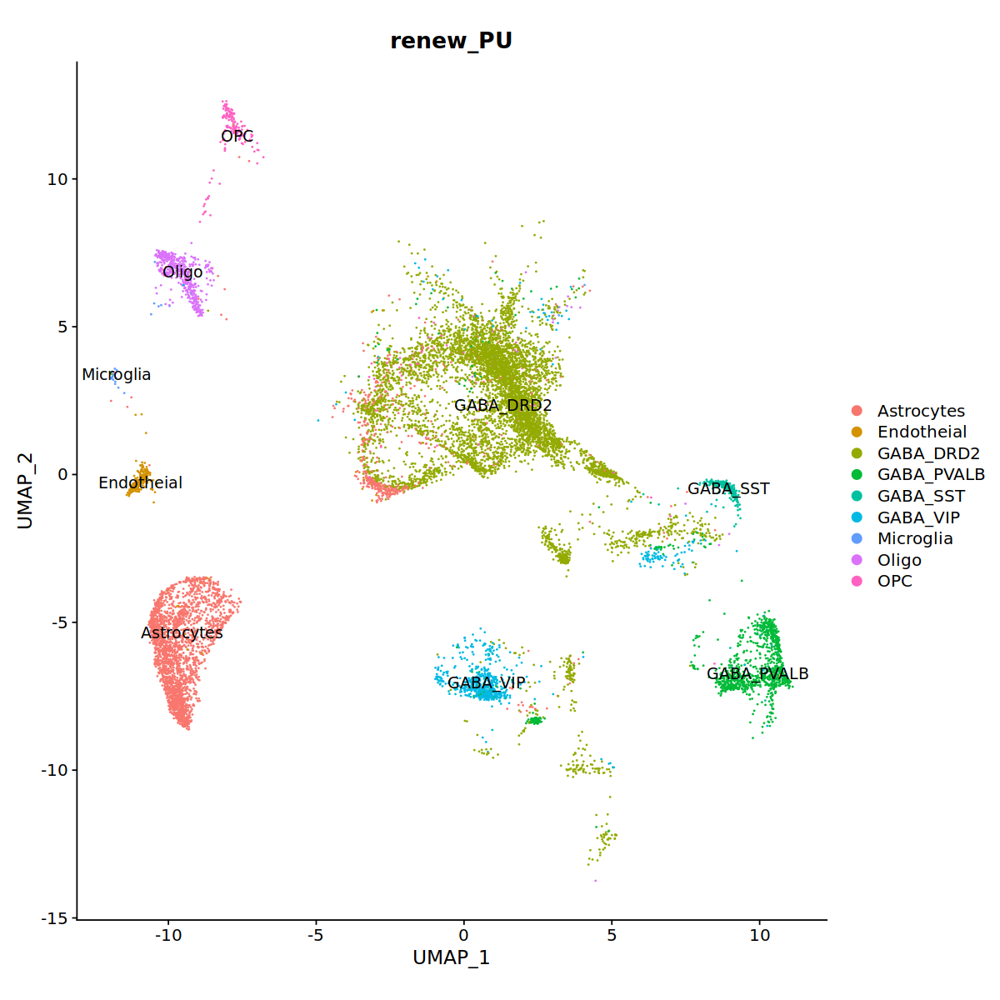

In [5]:
#knn算每个cluster附近细胞

sub=cla

# We try to infer the cell type by integrated result
trainUmapDf = as.data.frame(sub@reductions$umap@cell.embeddings)
identical(rownames(trainUmapDf), rownames(sub@meta.data))
trainCl = sub$SuperCluster

testUmapDf = as.data.frame(subset(integrateSeurat, group=="Putamen")@reductions$umap@cell.embeddings)

umapPred = knn(trainUmapDf, testUmapDf, trainCl, k=10, prob=T)
str(umapPred)
integrateSpatialSeurat = subset(integrateSeurat, group=="Putamen")
integrateSpatialSeurat$umapPredclusters = as.factor(as.character(umapPred))
integrateSpatialSeurat$umapPredclustersProb = attr(umapPred, "prob")

df_score=integrateSpatialSeurat@meta.data[,c('clusterNameMod','umapPredclusters','umapPredclustersProb')]
df_score=df_score[df_score$umapPredclustersProb >= 0.8,]

df_sum=df_score %>% group_by(clusterNameMod,umapPredclusters) %>% summarise(score=sum(umapPredclustersProb))

df_out1=df_sum %>% group_by(clusterNameMod) %>% top_n(n=1,wt=score)
colnames(df_out1)=c('clusterNameMod','umapPredclusters1','score1')

df_out2=df_sum %>% group_by(clusterNameMod) %>% top_n(n=2,wt=score)
df_out3=df_out2 %>% group_by(clusterNameMod) %>% top_n(n=-1,wt=score)
colnames(df_out3)=c('clusterNameMod','umapPredclusters2','score2')

df_out_sum=left_join(df_out1,df_out3)

df_out_sum$score3=df_out_sum$score1-df_out_sum$score2

df_out_sum$final_test='aba'
df_out_sum[df_out_sum$score3 <= df_out_sum$score2 *10,]$final_test='F'
df_out_sum[df_out_sum$score3==0,]$final_test='T'
df_out_sum[df_out_sum$score3 > df_out_sum$score2 *10,]$final_test='T'


table(df_out_sum$final_test)

df_out_sum[df_out_sum$final_test=='F',]


#重新拾回来扔掉的非神经元
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
df_sub_F_fil_type=df_sub_F$clusterNameMod
for(i in df_sub_F_fil_type){
    name1=df_sub_F[df_sub_F$clusterNameMod==i,]$clusterNameMod
    name2=df_sub_F[df_sub_F$clusterNameMod==i,]$umapPredclusters1
    if(length(grep('GLUT',name1))==0 & length(grep('GLUT',name1))==0 & length(grep('GLUT',name2))==0 & length(grep('GLUT',name2))==0){
      df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
    }
}

#重新判断MSN 慎重！！！非必要不加
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
msn_n=df_sub_F$clusterNameMod[grep('MSN',df_sub_F$clusterNameMod)]
if(length(msn_n)>0){
    for(i in msn_n){
        if(df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1=='MSN' | 
          df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2=='MSN'){
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
        }
    }
}
df_out_sum[df_out_sum$clusterNameMod=='Putamen_GABA_DRD1',]$umapPredclusters1='GABA_DRD2'
df_out_sum[df_out_sum$clusterNameMod=='Putamen_GABA_DRD2',]$umapPredclusters1='GABA_DRD2'
df_out_sum[df_out_sum$clusterNameMod=='Putamen_GABA_DRD1',]$final_test='T'
df_out_sum[df_out_sum$clusterNameMod=='Putamen_GABA_DRD2',]$final_test='T'


#扔掉大类不符的细胞类型
df_out_sum$rename1='NoNeuron'
df_out_sum[grep('EX',df_out_sum$clusterNameMod),]$rename1='EX'
df_out_sum[grep('IN',df_out_sum$clusterNameMod),]$rename1='IN'

df_out_sum$rename2='NoNeuron'
df_out_sum[grep('EX',df_out_sum$umapPredclusters1),]$rename2='EX'
df_out_sum[grep('IN',df_out_sum$umapPredclusters1),]$rename2='IN'

df_out_sum[df_out_sum$rename1 != df_out_sum$rename2,]$final_test='F'

#扔掉打分过低的细胞类型
df_out_sum[df_out_sum$score1 <5,]$final_test='F'


df_out_sum1=df_out_sum[,c('clusterNameMod','umapPredclusters1','final_test')]
df_out_sum1=df_out_sum1[!duplicated(df_out_sum1),]
nrow(df_out_sum1)
df_out_sum1=df_out_sum1[df_out_sum1$final_test=='T',]
nrow(df_out_sum1)


sub_PU=subset(integrateSeurat,group=='Putamen')

sub_PU=subset(sub_PU,clusterNameMod %in% df_out_sum1$clusterNameMod)
df_compare=sub_PU@meta.data[,c('clusterNameMod','group'),drop=F]
df_compare=left_join(df_compare,df_out_sum1)

sub_PU=AddMetaData(sub_PU,df_compare$umapPredclusters1,col.name = 'renew_PU')
p2=DimPlot(sub_PU, reduction="umap", group.by="renew_PU", label=T)+coord_fixed()

p2


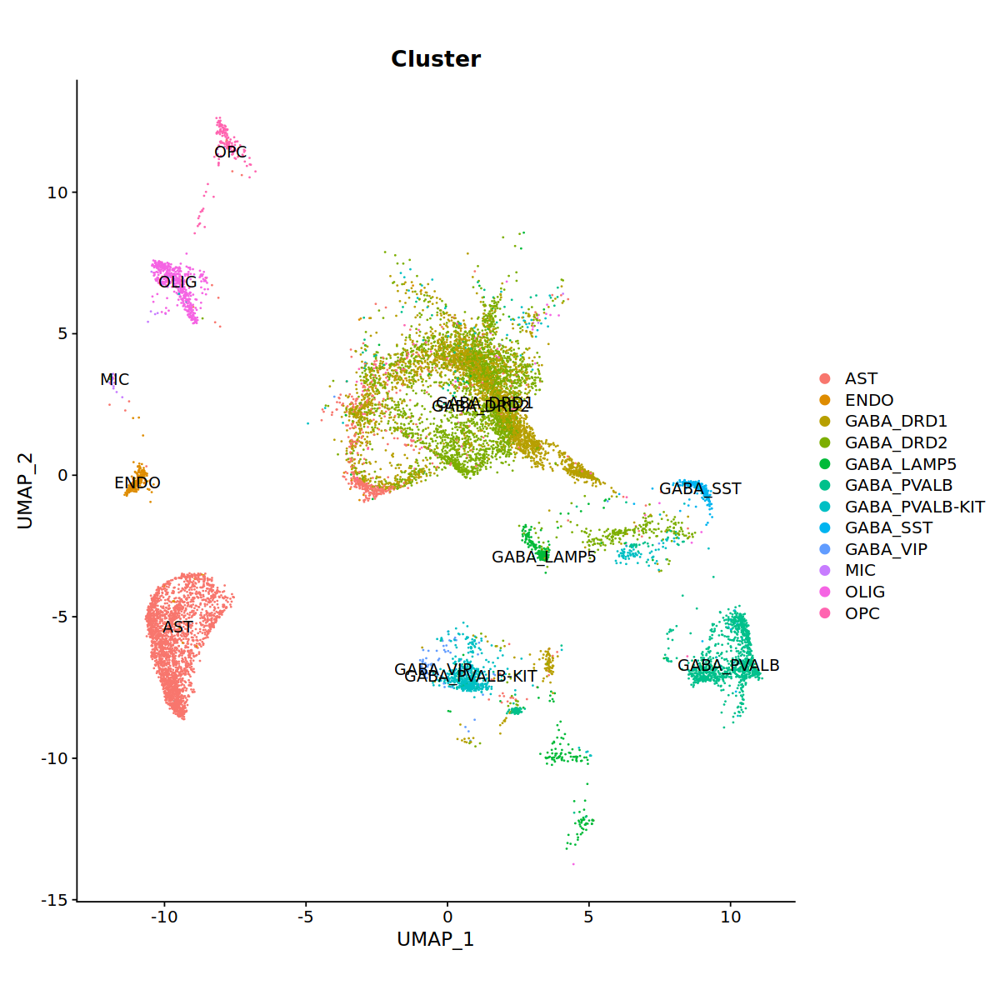

In [6]:
DimPlot(sub_PU, reduction="umap", group.by="Cluster", label=T)+coord_fixed()


[1] TRUE

 Factor w/ 16 levels "Astrocytes","Endotheial",..: 11 11 11 11 11 11 11 11 11 11 ...
 - attr(*, "prob")= num [1:11939] 1 0.8 0.9 1 0.8 1 1 1 1 1 ...


`summarise()` has grouped output by 'clusterNameMod'. You can override using
the `.groups` argument.
Joining, by = "clusterNameMod"



 F  T 
11 19 

[1] 30

[1] 25

Joining, by = "clusterNameMod"


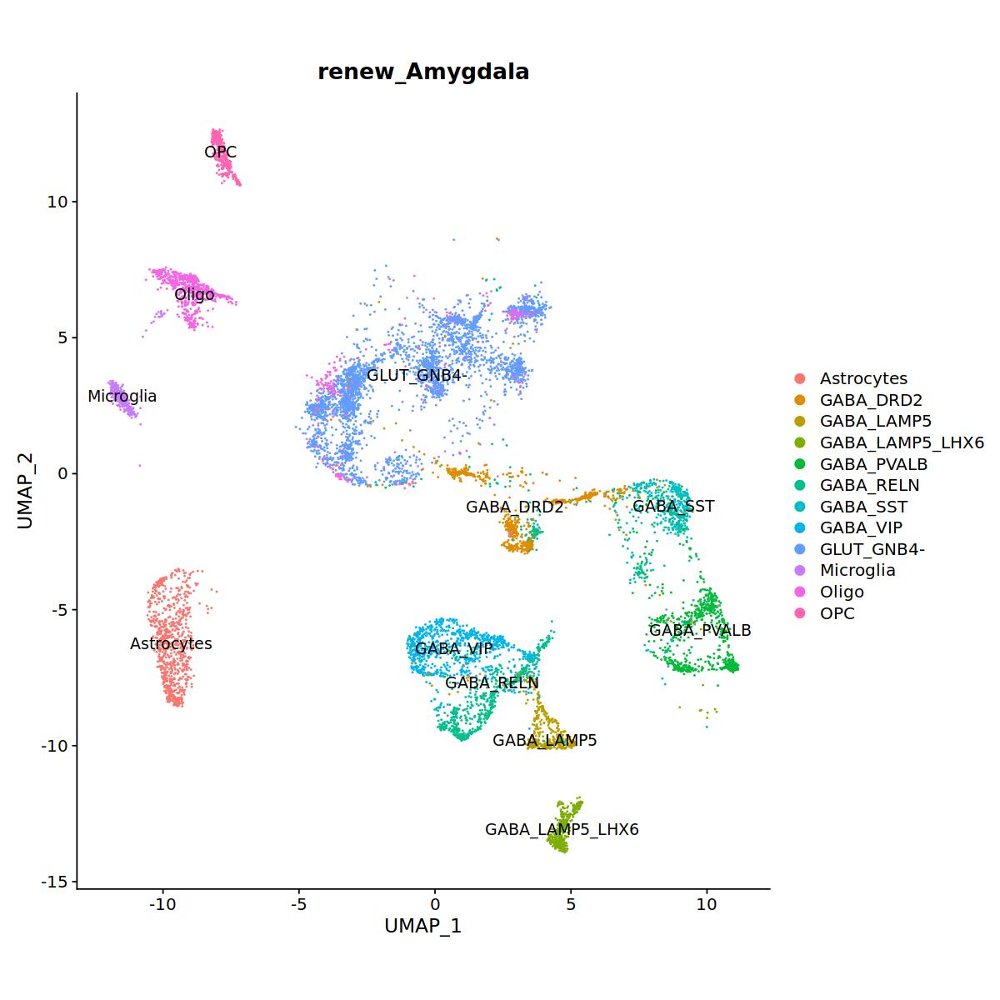

In [7]:
#knn算每个cluster附近细胞

sub=cla

# We try to infer the cell type by integrated result
trainUmapDf = as.data.frame(sub@reductions$umap@cell.embeddings)
identical(rownames(trainUmapDf), rownames(sub@meta.data))
trainCl = sub$SuperCluster

testUmapDf = as.data.frame(subset(integrateSeurat, group=="Amygdala")@reductions$umap@cell.embeddings)

umapPred = knn(trainUmapDf, testUmapDf, trainCl, k=10, prob=T)
str(umapPred)
integrateSpatialSeurat = subset(integrateSeurat, group=="Amygdala")
integrateSpatialSeurat$umapPredclusters = as.factor(as.character(umapPred))
integrateSpatialSeurat$umapPredclustersProb = attr(umapPred, "prob")

df_score=integrateSpatialSeurat@meta.data[,c('clusterNameMod','umapPredclusters','umapPredclustersProb')]
df_score=df_score[df_score$umapPredclustersProb >= 0.8,]

df_sum=df_score %>% group_by(clusterNameMod,umapPredclusters) %>% summarise(score=sum(umapPredclustersProb))

df_out1=df_sum %>% group_by(clusterNameMod) %>% top_n(n=1,wt=score)
colnames(df_out1)=c('clusterNameMod','umapPredclusters1','score1')

df_out2=df_sum %>% group_by(clusterNameMod) %>% top_n(n=2,wt=score)
df_out3=df_out2 %>% group_by(clusterNameMod) %>% top_n(n=-1,wt=score)
colnames(df_out3)=c('clusterNameMod','umapPredclusters2','score2')

df_out_sum=left_join(df_out1,df_out3)

df_out_sum$score3=df_out_sum$score1-df_out_sum$score2

df_out_sum$final_test='aba'
df_out_sum[df_out_sum$score3 <= df_out_sum$score2 *10,]$final_test='F'
df_out_sum[df_out_sum$score3==0,]$final_test='T'
df_out_sum[df_out_sum$score3 > df_out_sum$score2 *10,]$final_test='T'


table(df_out_sum$final_test)

#重新拾回来扔掉的非神经元
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
df_sub_F_fil_type=df_sub_F$clusterNameMod
for(i in df_sub_F_fil_type){
    name1=df_sub_F[df_sub_F$clusterNameMod==i,]$clusterNameMod
    name2=df_sub_F[df_sub_F$clusterNameMod==i,]$umapPredclusters1
    if(length(grep('GLUT',name1))==0 & length(grep('GLUT',name1))==0 & length(grep('GLUT',name2))==0 & length(grep('GLUT',name2))==0){
      df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
    }
}

#重新判断MSN 慎重！！！非必要不加
df_sub_F=df_out_sum[df_out_sum$final_test=='F',]
msn_n=df_sub_F$clusterNameMod[grep('MSN',df_sub_F$clusterNameMod)]
if(length(msn_n)>0){
    for(i in msn_n){
        if(df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1=='MSN' |
          df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2=='MSN'){
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters1='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$umapPredclusters2='MSN'
            df_out_sum[df_out_sum$clusterNameMod==i,]$final_test='T'
        }
    }
}

#扔掉大类不符的细胞类型
df_out_sum$rename1='NoNeuron'
df_out_sum[grep('Excit',df_out_sum$clusterNameMod),]$rename1='EX'
df_out_sum[grep('Inhibit',df_out_sum$clusterNameMod),]$rename1='IN'

df_out_sum$rename2='NoNeuron'
df_out_sum[grep('EX',df_out_sum$umapPredclusters1),]$rename2='EX'
df_out_sum[grep('IN',df_out_sum$umapPredclusters1),]$rename2='IN'

df_out_sum[df_out_sum$rename1 != df_out_sum$rename2,]$final_test='F'

#扔掉打分过低的细胞类型
df_out_sum[df_out_sum$score1 <5,]$final_test='F'


df_out_sum1=df_out_sum[,c('clusterNameMod','umapPredclusters1','final_test')]
df_out_sum1=df_out_sum1[!duplicated(df_out_sum1),]
nrow(df_out_sum1)
df_out_sum1=df_out_sum1[df_out_sum1$final_test=='T',]
nrow(df_out_sum1)

sub_Amygdala=subset(integrateSeurat,group=='Amygdala')

sub_Amygdala=subset(sub_Amygdala,clusterNameMod %in% df_out_sum1$clusterNameMod)
df_compare=sub_Amygdala@meta.data[,c('clusterNameMod','group'),drop=F]
df_compare=left_join(df_compare,df_out_sum1)

sub_Amygdala=AddMetaData(sub_Amygdala,df_compare$umapPredclusters1,col.name = 'renew_Amygdala')

p3=DimPlot(sub_Amygdala, reduction="umap", group.by="renew_Amygdala", label=T)+coord_fixed()

p3

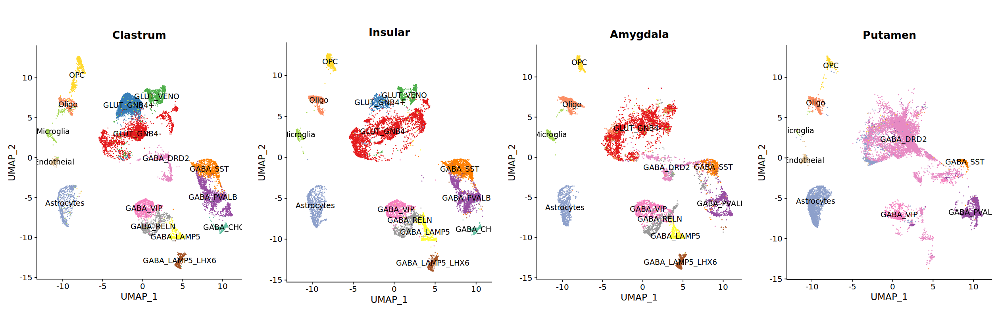

In [8]:
df_col=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/macaca/sn_0821_renew_batch3_all/batch_normalize_renew_0105/post_analysis/data/color_supercluster.csv')
col=df_col$pale
names(col)=df_col$X

options(repr.plot.width=21, repr.plot.height=7)
gp=plot_grid(DimPlot(cla, reduction="umap",label=T,group.by = 'SuperCluster',raster=FALSE,cols=col)+coord_fixed()+NoLegend()+ggtitle('Clastrum'),
          DimPlot(sub_Insular, reduction="umap", group.by="renew_Insular", label=T,cols=col)+coord_fixed()+ggtitle('Insular')+NoLegend(),
          DimPlot(sub_Amygdala, reduction="umap", group.by="renew_Amygdala", label=T,cols=col)+coord_fixed()+ggtitle('Amygdala')+NoLegend(),
          DimPlot(sub_PU, reduction="umap", group.by="renew_PU", label=T,cols=col)+coord_fixed()+ggtitle('Putamen')+NoLegend(), ncol =4)
gp

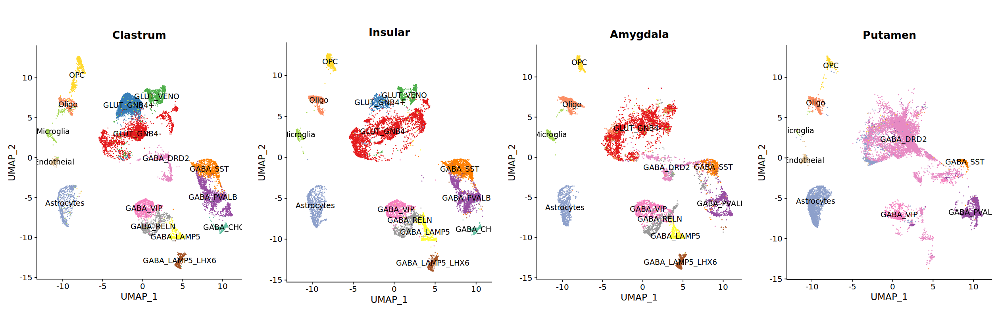

In [9]:
gp

In [10]:
png("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/umap_sup.png")
gp
dev.off()


png 
  2

In [11]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/umap_sup.pdf", width=21, height=7)
gp
dev.off()


png 
  2

In [12]:

datadir1='/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240123/data/'
cla_meta=read.csv(paste0(datadir1,'cla_meta.csv'))
insu_meta=read.csv(paste0(datadir1,'insu_meta.csv'))
amy_meta=read.csv(paste0(datadir1,'amy_meta.csv'))
puta_meta=read.csv(paste0(datadir1,'puta_meta.csv'))


In [13]:
Insular_compare=sub_Insular@meta.data[,c('Cluster','renew_Insular')]
rownames(Insular_compare)=NULL
Insular_compare=Insular_compare[!duplicated(Insular_compare),]
insu_meta=left_join(insu_meta,Insular_compare)


Putamen_compare=sub_PU@meta.data[,c('Cluster','renew_PU')]
rownames(Putamen_compare)=NULL
Putamen_compare=Putamen_compare[!duplicated(Putamen_compare),]
puta_meta=left_join(puta_meta,Putamen_compare)

Amygdala_compare=sub_Amygdala@meta.data[,c('Cluster','renew_Amygdala')]
rownames(Amygdala_compare)=NULL
Amygdala_compare=Amygdala_compare[!duplicated(Amygdala_compare),]
amy_meta=left_join(amy_meta,Amygdala_compare)



Joining, by = "Cluster"
Joining, by = "Cluster"
Joining, by = "Cluster"


In [14]:
df1=as.data.frame(table(cla_meta$SuperCluster))
df2=as.data.frame(table(insu_meta$renew_Insular))
df3=as.data.frame(table(puta_meta$renew_PU))
df4=as.data.frame(table(amy_meta$renew_Amygdala))


Warning message in `[<-.factor`(`*tmp*`, ri, value = "sepcific_cell_type"):
“invalid factor level, NA generated”


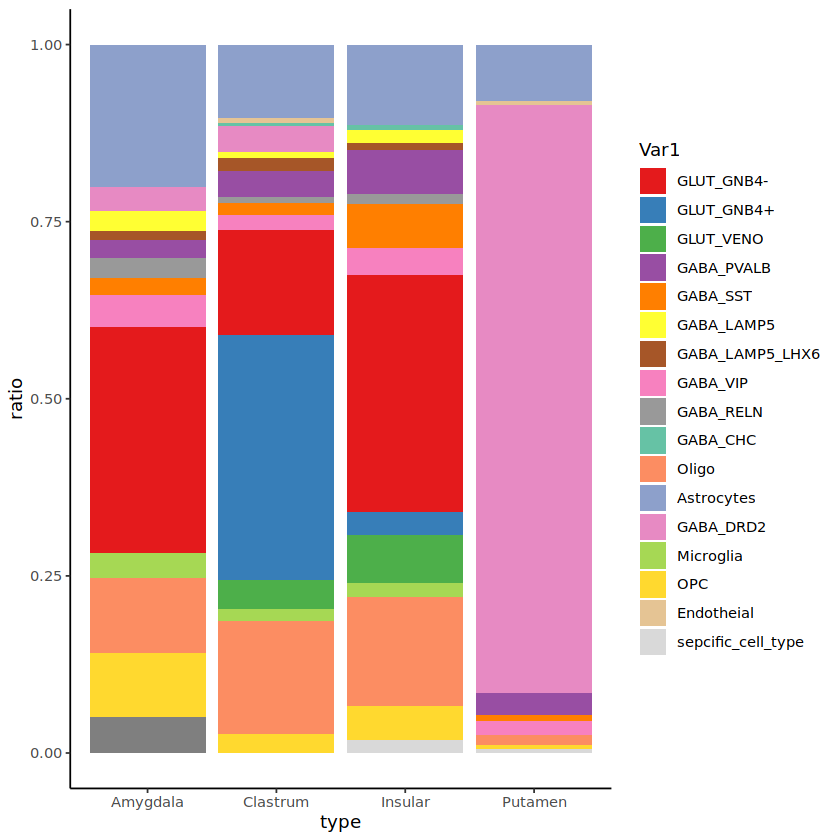

In [15]:


sub_Insular_raw=subset(integrateSeurat,group=='Insular')
sub_Insular_fil=subset(sub_Insular_raw,cells =  setdiff(colnames(sub_Insular_raw),colnames(sub_Insular)))

sub_PU_raw=subset(integrateSeurat,group=='Putamen')
sub_PU_fil=subset(sub_PU_raw,cells =  setdiff(colnames(sub_PU_raw),colnames(sub_PU)))

sub_Amygdala_raw=subset(integrateSeurat,group=='Amygdala')
sub_Amygdala_fil=subset(sub_Amygdala_raw,cells =  setdiff(colnames(sub_Amygdala_raw),colnames(sub_Amygdala)))

df2$Var1=as.character(df2$Var1)
df3$Var1=as.character(df3$Var1)
df2=rbind(df2,c('sepcific_cell_type',ncol(sub_Insular_fil)))
df3=rbind(df3,c('sepcific_cell_type',ncol(sub_PU_fil)))
df4=rbind(df4,c('sepcific_cell_type',ncol(sub_Amygdala_fil)))


df1$Freq=as.numeric(df1$Freq)
df2$Freq=as.numeric(df2$Freq)
df3$Freq=as.numeric(df3$Freq)
df4$Freq=as.numeric(df4$Freq)

df1$ratio=df1$Freq/sum(df1$Freq)
df2$ratio=df2$Freq/sum(df2$Freq)
df3$ratio=df3$Freq/sum(df3$Freq)
df4$ratio=df4$Freq/sum(df4$Freq)

df1$type='Clastrum'
df2$type='Insular'
df3$type='Putamen'
df4$type='Amygdala'

df_all=rbind(df1,df2,df3,df4)
df_all$Freq=NULL
df_all$Var1=as.character(df_all$Var1)

df_col=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/macaca/sn_0821_renew_batch3_all/batch_normalize_renew_0105/post_analysis/data/color_supercluster.csv')
df_col=rbind(df_col,c('sepcific_cell_type','#D9D9D9'))
cols=df_col$pale
names(cols)=df_col$X

options(repr.plot.width=7, repr.plot.height=7)
gp=ggplot(data = df_all, aes(x = type, y = ratio, fill = Var1)) +
 geom_bar(stat = "identity", position = "stack")+theme_classic()+
scale_fill_manual(values = cols)
gp

In [16]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/bili_sup.pdf", width=7, height=7)
gp
dev.off()


png 
  2

In [17]:
combineSeuratList = list(
    Insular=sub_Insular,
    PU=sub_PU,
    CLA=cla,
    Amygdala=sub_Amygdala
)
combineSeuratList = lapply(combineSeuratList, function(seurat) {
    seurat = SCTransform(
        seurat, assay="RNA",
        ncells=ncol(seurat[["RNA"]]), 
        variable.features.n=3000,
        return.only.var.genes = F,
        method = "glmGamPoi"
    ) %>%
        RunPCA(verbose = FALSE) %>%
        FindNeighbors(dims = 1:30) %>%
        FindClusters(verbose = FALSE) %>%
        RunUMAP(dims = 1:30)
    return(seurat)
})

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 20042 by 12600

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 12600 cells



  |======================================================================| 100%


Found 78 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 20042 genes



  |======================================================================| 100%


Computing corrected count matrix for 20042 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.951172 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Computing nearest neighbor graph

Computing SNN

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
13:21:56 UMAP embedding parameters a = 0.9922 b = 1.112

13:21:56 Read 12600 rows and found 30 numeric columns

13:21:56 Using Annoy for neighbor search, n_neighbors = 30

13:21:56 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:21:59 W

  |======================================================================| 100%


Found 29 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 14564 genes



  |======================================================================| 100%


Computing corrected count matrix for 14564 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.002201 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Computing nearest neighbor graph

Computing SNN

13:25:06 UMAP embedding parameters a = 0.9922 b = 1.112

13:25:06 Read 12376 rows and found 30 numeric columns

13:25:06 Using Annoy for neighbor search, n_neighbors = 30

13:25:06 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:25:07 Writing NN index file to temp file /tmp/RtmpTI9cf0/file2498868079c69

13:25:07 Searching Annoy index using 1 thread, search_k = 3000

13:25:10 Annoy recall = 100%

13:25:12 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:25:14 Initializing fro

  |======================================================================| 100%


Found 91 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 18741 genes



  |======================================================================| 100%


Computing corrected count matrix for 18741 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.557279 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Computing nearest neighbor graph

Computing SNN

13:28:50 UMAP embedding parameters a = 0.9922 b = 1.112

13:28:50 Read 14400 rows and found 30 numeric columns

13:28:50 Using Annoy for neighbor search, n_neighbors = 30

13:28:50 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:28:52 Writing NN index file to temp file /tmp/RtmpTI9cf0/file2498830505bd3

13:28:52 Searching Annoy index using 1 thread, search_k = 3000

13:28:55 Annoy recall = 100%

13:28:57 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:29:00 Initializing fro

  |======================================================================| 100%


Found 104 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 18723 genes



  |======================================================================| 100%


Computing corrected count matrix for 18723 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 1.662971 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Computing nearest neighbor graph

Computing SNN

13:31:37 UMAP embedding parameters a = 0.9922 b = 1.112

13:31:37 Read 9939 rows and found 30 numeric columns

13:31:37 Using Annoy for neighbor search, n_neighbors = 30

13:31:37 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:31:39 Writing NN index file to temp file /tmp/RtmpTI9cf0/file249885d9128b1

13:31:39 Searching Annoy index using 1 thread, search_k = 3000

13:31:41 Annoy recall = 100%

13:31:43 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

13:31:46 Initializing from

In [18]:
sub_CLA1=combineSeuratList[['CLA']]
sub_Insular1=combineSeuratList[['Insular']]
sub_PU1=combineSeuratList[['PU']]
sub_Amygdala1=combineSeuratList[['Amygdala']]


In [ ]:

Idents(sub_CLA1) = "SuperCluster"
sub_CLA1_marker=subset(sub_CLA1,downsample=1000)
DefaultAssay(sub_CLA1_marker) = "SCT"
CLASubclassMarker = FindAllMarkers(sub_CLA1_marker)

Idents(sub_Insular1) = "renew_Insular"
sub_Insular1_marker=subset(sub_Insular1,downsample=1000)
DefaultAssay(sub_Insular1_marker) = "SCT"
InsularSubclassMarker = FindAllMarkers(sub_Insular1_marker)

Idents(sub_Amygdala1) = "renew_Amygdala"
sub_Amygdala1_marker=subset(sub_Amygdala1,downsample=1000)
DefaultAssay(sub_Amygdala1_marker) = "SCT"
AmygdalaSubclassMarker = FindAllMarkers(sub_Amygdala1_marker)

Idents(sub_PU1) = "renew_PU"
sub_PU1_marker=subset(sub_PU1,downsample=1000)
DefaultAssay(sub_PU1_marker) = "SCT"
PUSubclassMarker = FindAllMarkers(sub_PU1_marker)


Calculating cluster GLUT_GNB4-

Calculating cluster GLUT_VENO

Calculating cluster GLUT_GNB4+

Calculating cluster GABA_VIP

Calculating cluster GABA_PVALB

Calculating cluster GABA_SST

Calculating cluster GABA_CHC

Calculating cluster GABA_RELN

Calculating cluster GABA_LAMP5

Calculating cluster GABA_LAMP5_LHX6

Calculating cluster Microglia

Calculating cluster Oligo

Calculating cluster GABA_DRD2

Calculating cluster Astrocytes

Calculating cluster OPC

Calculating cluster Endotheial

Calculating cluster Astrocytes

Calculating cluster GABA_CHC

Calculating cluster GABA_LAMP5

Calculating cluster GABA_LAMP5_LHX6

Calculating cluster GABA_PVALB

Calculating cluster GABA_RELN

Calculating cluster GABA_SST

Calculating cluster GABA_VIP

Calculating cluster GLUT_GNB4-

Calculating cluster GLUT_GNB4+

Calculating cluster GLUT_VENO

Calculating cluster Microglia

Calculating cluster Oligo

Calculating cluster OPC

Calculating cluster Astrocytes



In [ ]:
InsularSubclassFiltMarker = subset(InsularSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.7)
CLASubclassFiltMarker = subset(CLASubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.7)
PUSubclassFiltMarker = subset(PUSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.7)
AmygdalaSubclassMarker = subset(AmygdalaSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.7)


InsularSubclassFiltMarker$species = "Insular"
CLASubclassFiltMarker$species = "CLA"
PUSubclassFiltMarker$species = "PU"
AmygdalaSubclassMarker$species = "Amygdala"


subclassFiltMarkerTb = as_tibble(Reduce(rbind, list(
    InsularSubclassFiltMarker, CLASubclassFiltMarker,
    PUSubclassFiltMarker,AmygdalaSubclassMarker
)))
str(subclassFiltMarkerTb)



In [ ]:

subclassFiltMarkerTb = subclassFiltMarkerTb %>% group_by(cluster, gene) %>% mutate(
    conservedSpeciesNum = n(),
    conservedSpeciesPair = paste(sort(species), collapse="&"),
    conservedFlag = ifelse(
        conservedSpeciesNum == 4, "conserved", ifelse(
            conservedSpeciesNum == 1, "speciesDiff", "partialConserved"
        )
    )
) %>% ungroup()




In [ ]:
table(subclassFiltMarkerTb$conservedFlag)

length(unique(subset(subclassFiltMarkerTb, conservedFlag=="conserved")$gene))
length(unique(subset(subclassFiltMarkerTb, conservedFlag=="partialConserved")$gene))
length(unique(subset(subclassFiltMarkerTb, conservedFlag=="speciesDiff")$gene))

subclassFiltMarkerTb$cluster = factor(as.character(subclassFiltMarkerTb$cluster))
subclassFiltMarkerTb = subclassFiltMarkerTb %>% arrange(species, cluster, avg_log2FC)
levels(subclassFiltMarkerTb$cluster)

head(subclassFiltMarkerTb)

In [ ]:
write.csv(subclassFiltMarkerTb,'/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3area_compare_240123/compare_to_nearby/4area_subclassFiltMarkerTb.csv')



In [1]:
subclassFiltMarkerTb=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3area_compare_240123/compare_to_nearby/4area_subclassFiltMarkerTb.csv')



In [4]:
length(unique(subclassFiltMarkerTb$gene))

[1] 1574

In [18]:
all_n=unique(subclassFiltMarkerTb$conservedSpeciesPair)
fil_n=all_n[grep('^[A-Za-z]*&[A-Za-z]*&[A-Za-z]*$',all_n)]
sel_n=setdiff(all_n,fil_n)
subclassFiltMarkerTb1=subclassFiltMarkerTb[subclassFiltMarkerTb$conservedSpeciesPair %in% sel_n,]

table(subclassFiltMarkerTb1$conservedSpeciesPair)



               Amygdala            Amygdala&CLA Amygdala&CLA&Insular&PU 
                    153                     104                     568 
       Amygdala&Insular             Amygdala&PU                     CLA 
                    144                      18                     600 
            CLA&Insular                  CLA&PU                 Insular 
                    860                     250                     277 
             Insular&PU                      PU 
                      8                      95 

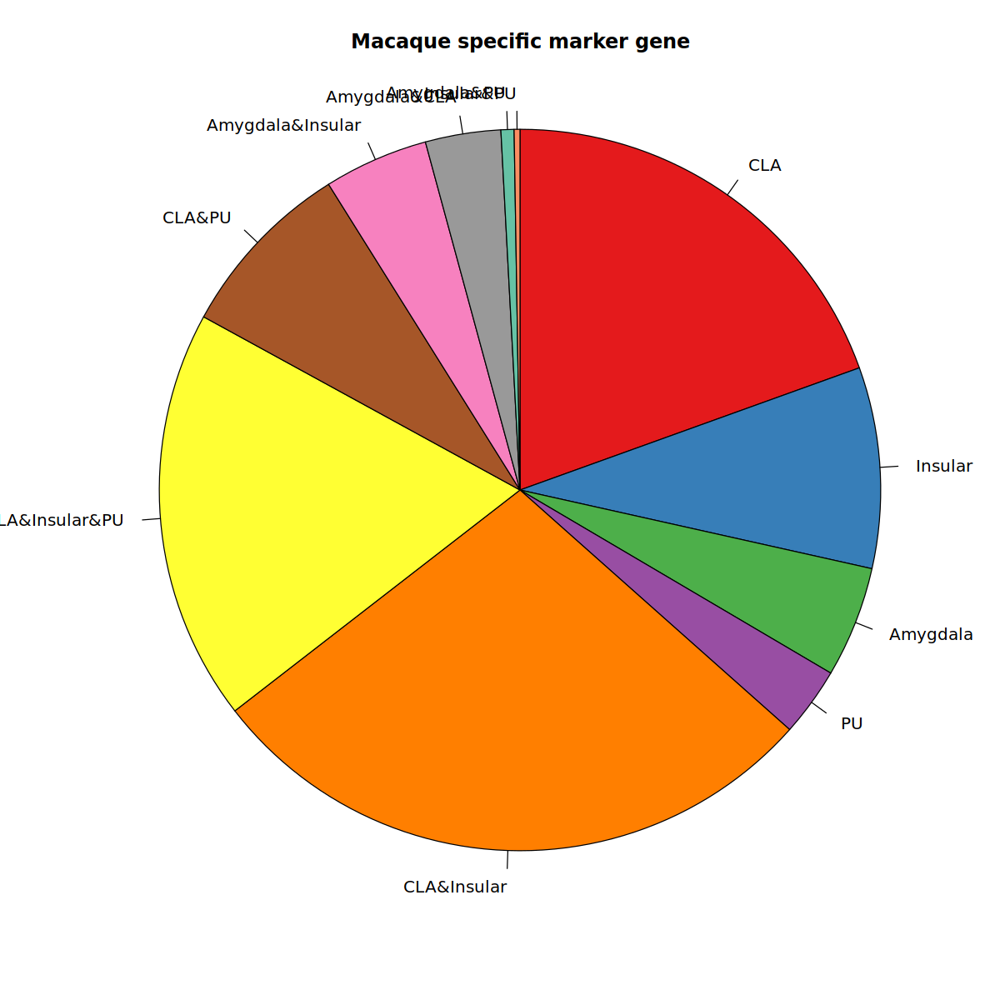

In [19]:
df=as.data.frame(table(subclassFiltMarkerTb1$conservedSpeciesPair))
df=df[df$Freq>0,]

order1=as.character(df[order(df$Freq,decreasing = T),]$Var1)
order1_1=order1[grep('&',order1)]
order1_2=setdiff(order1,order1_1)
order=c(order1_2,order1_1)
df$Var1=factor(df$Var1,levels=order)
df=df[order(df$Var1),]

options(repr.plot.width=10, repr.plot.height=10)
pie(df$Freq, labels=df$Var1,
    radius = 1.0,clockwise=T,
    col = col,
    main = "Macaque specific marker gene")


In [20]:

A <- df
library(ggplot2)
library(ggforce)
 
gp=ggplot()+
  theme(panel.grid.major = element_blank(),
        panel.grid.minor = element_blank(),
        axis.ticks = element_blank(), 
        axis.text.y = element_blank(),
        axis.text.x = element_blank(),
        legend.title=element_blank(), 
        panel.border = element_blank(),
        panel.background = element_blank())+#去除没用的ggplot背景，坐标轴
  xlab("")+ylab('')+#添加颜色
  scale_fill_manual(values =col)+
  geom_arc_bar(data=A,
               stat = "pie",
               aes(x0=0,y0=0,r0=0,r=2,
                   amount=Freq,fill=Var1)
  )

In [21]:
sum(df$Freq)
df$ratio=df$Freq/3077
df

[1] 3077

,Var1,Freq,ratio
,<fct>,<int>,<dbl>
6,CLA,600,0.194995125
9,Insular,277,0.090022749
1,Amygdala,153,0.049723757
11,PU,95,0.030874228
7,CLA&Insular,860,0.279493013
3,Amygdala&CLA&Insular&PU,568,0.184595385
8,CLA&PU,250,0.081247969
4,Amygdala&Insular,144,0.046798830
2,Amygdala&CLA,104,0.033799155


In [48]:



pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/pie.pdf", width=10, height=10)

pie(df$Freq, labels=df$Var1,
    radius = 1.0,clockwise=T,
    col = col,
    main = "Macaque specific marker gene")


dev.off()





pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/pie1.pdf", width=10, height=10)
gp
dev.off()


png 
  2

png 
  2

In [35]:
df_col=data.frame(type=c('CLA','PU','Insular','Amygdala'),
                 col=c('#E41A1C','#377EB8','#4DAF4A','#984EA3'))

df_col=rbind(df_col,c(
'Amygdala&CLA',colorRampPalette(c("#984EA3", "#E41A1C"))(10)[5]))

df_col=rbind(df_col,c(
'Amygdala&Insular',colorRampPalette(c("#984EA3", "#4DAF4A"))(10)[5]))

df_col=rbind(df_col,c(
'Amygdala&PU',colorRampPalette(c("#984EA3", "#377EB8"))(10)[5]))

df_col=rbind(df_col,c(
'CLA&Insular',colorRampPalette(c("#E41A1C", "#4DAF4A"))(10)[5]))

df_col=rbind(df_col,c(
'CLA&PU',colorRampPalette(c("#E41A1C", "#377EB8"))(10)[5]))

df_col=rbind(df_col,c(
'Insular&PU',colorRampPalette(c("#4DAF4A", "#377EB8"))(10)[5]))

df_col=rbind(df_col,c(
'Amygdala&CLA&Insular&PU','grey'))

col=df_col$col
names(col)=df_col$type
  
  

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               Amygdala            Amygdala&CLA    Amygdala&CLA&Insular 
                     15                       4                      88 
Amygdala&CLA&Insular&PU         Amygdala&CLA&PU        Amygdala&Insular 
                     38                       1                      32 
    Amygdala&Insular&PU                     CLA             CLA&Insular 
                      1                      63                      10 
                 CLA&PU                 Insular                      PU 
                      8                      26                       2 

[1] FALSE

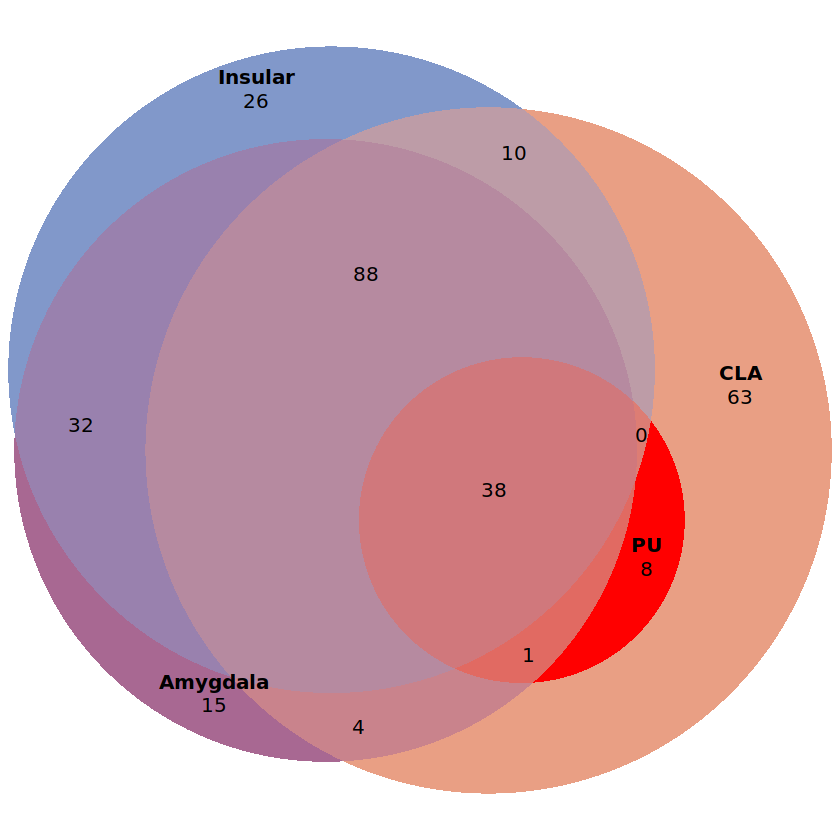

In [23]:
#效果不好故省略
tmpTb = subset(subclassFiltMarkerTb, cluster == "Astrocytes") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr1 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

colorLeg = c("Amygdala"="#A86892", "Insular"="#E99F84", "CLA"="#8198CA",'PU'='red')
p1 = plot(elr1, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p1

In [24]:
in1=intersect(rownames(sub_CLA1_down100),rownames(sub_Insular1_down100))
in2=intersect(rownames(sub_Amygdala1_down100),rownames(sub_PU1_down100))
inter=intersect(in1,in2)
subclassFiltMarkerTb=subclassFiltMarkerTb[subclassFiltMarkerTb$gene %in% inter,]

# sortLevel = c("L2/3 IT", "L6 CT", "L4 IT", "L6 IT", "L5 IT", "L6b", "L5 PT", "L5/6 NP", "Car3")
sortLevel = unique(subclassFiltMarkerTb$cluster)
sub_CLA1$annotSubclass = factor(sub_CLA1$SuperCluster, levels=sortLevel)
sub_Insular1$annotSubclass = factor(sub_Insular1$renew_Insular, levels=sortLevel)
sub_PU1$annotSubclass = factor(sub_PU1$renew_PU, levels=sortLevel)
sub_Amygdala1$annotSubclass = factor(sub_Amygdala1$renew_Amygdala, levels=sortLevel)



In [27]:


Idents(sub_CLA1) = "annotSubclass"
sub_CLA1_down100 = subset(sub_CLA1, downsample=100)
Idents(sub_Insular1) = "annotSubclass"
sub_Insular1_down100 = subset(sub_Insular1, downsample=100)
Idents(sub_PU1) = "annotSubclass"
sub_PU1_down100 = subset(sub_PU1, downsample=100)
Idents(sub_Amygdala1) = "annotSubclass"
sub_Amygdala1_down100 = subset(sub_Amygdala1, downsample=100)

In [28]:
sub_CLA1_down100

An object of class Seurat 
44523 features across 1600 samples within 3 assays 
Active assay: SCT (18741 features, 3000 variable features)
 2 other assays present: RNA, integrated
 3 dimensional reductions calculated: pca, tsne, umap

[1] 389

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



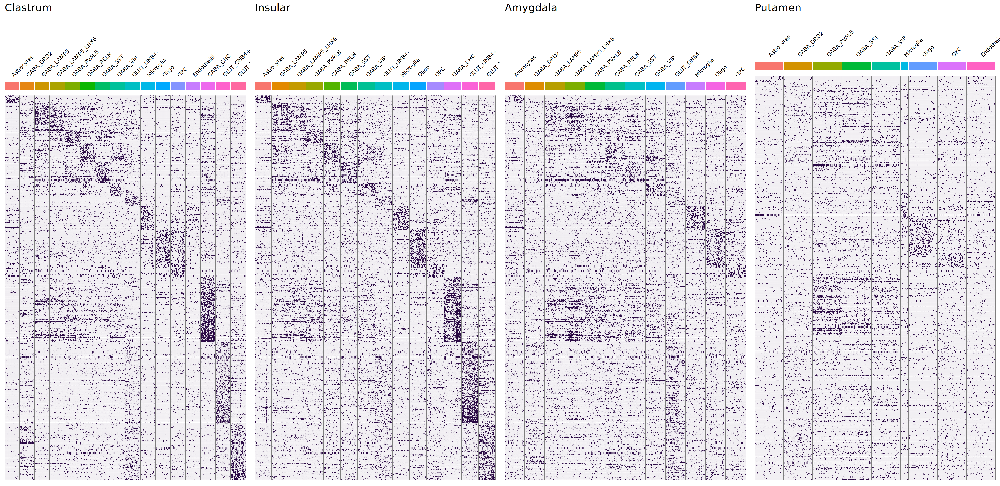

In [32]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="CLA&Insular")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg1 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg1



[1] 123

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



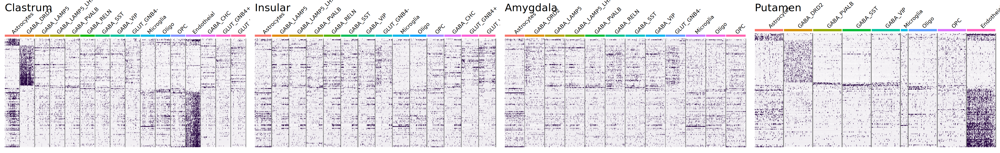

In [33]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="CLA&PU")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg2 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg2



[1] 50

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



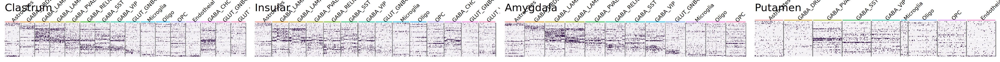

In [34]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="Amygdala&CLA")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg3 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg3



In [50]:
list_name1=c(1:nrow(sub_CLA1_down100@meta.data))[sub_CLA1_down100@meta.data$SuperCluster=='Astrocytes']
list_name2=c(1:nrow(sub_Insular1_down100@meta.data))[sub_Insular1_down100@meta.data$renew_Insular=='Astrocytes']
list_name3=c(1:nrow(sub_Amygdala1_down100@meta.data))[sub_Amygdala1_down100@meta.data$renew_Amygdala=='Astrocytes']
list_name4=c(1:nrow(sub_PU1_down100@meta.data))[sub_PU1_down100@meta.data$renew_PU=='Astrocytes']


mean(sub_CLA1_down100@assays$SCT@data[selectGene[1],list_name1])
mean(sub_Insular1_down100@assays$SCT@data[selectGene[1],list_name2])
mean(sub_Amygdala1_down100@assays$SCT@data[selectGene[1],list_name3])
mean(sub_PU1_down100@assays$SCT@data[selectGene[1],list_name4])


[1] 0.5812214

[1] 0.4537403

[1] 0.4807763

[1] 0.3032971

In [45]:
mean(sub_CLA1_down100@assays$SCT@data[selectGene[3],])
mean(sub_Insular1_down100@assays$SCT@data[selectGene[3],])
mean(sub_Amygdala1_down100@assays$SCT@data[selectGene[3],])
mean(sub_PU1_down100@assays$SCT@data[selectGene[3],])



[1] 0.9144507

[1] 1.105286

[1] 0.9636065

[1] 0.5216011

In [41]:
selectGene[1]

[1] "PFKFB3"

[1] 139

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



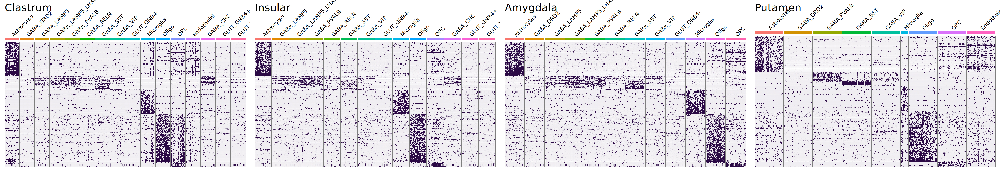

In [35]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="Amygdala&CLA&Insular&PU")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg4 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4



In [36]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat1.pdf", width=40, height=389/20)
pg1
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat2.pdf", width=40, height=123/20)
pg2
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat3.pdf", width=40, height=50/20)
pg3
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat4.pdf", width=40, height=139/20)
pg4
dev.off()

png 
  2

png 
  2

png 
  2

png 
  2

[1] 557

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



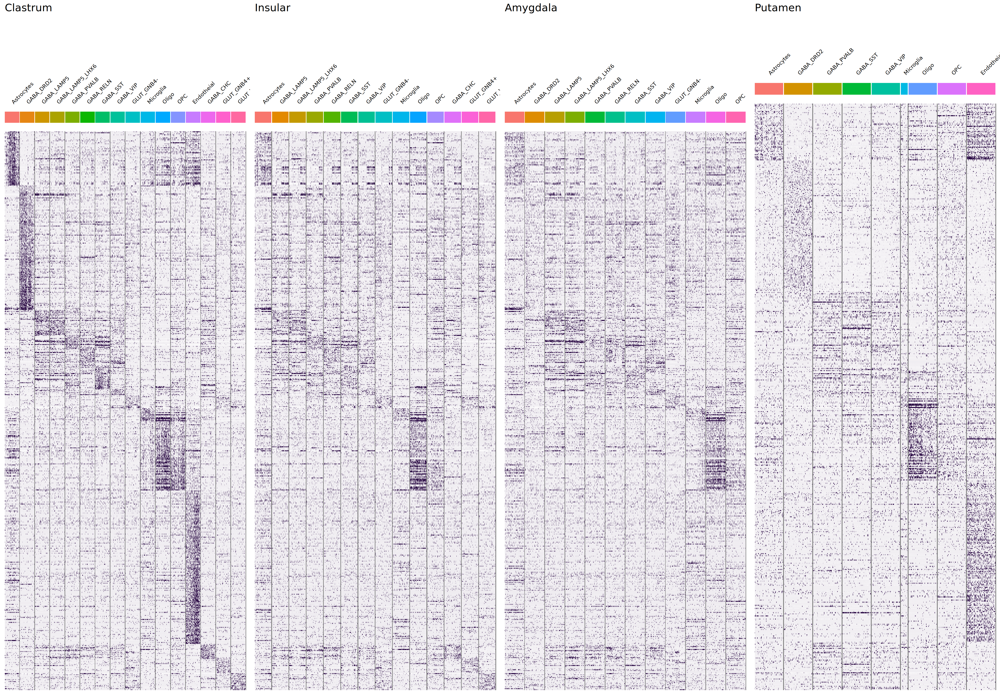

In [56]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="CLA")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg4 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4



[1] 148

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



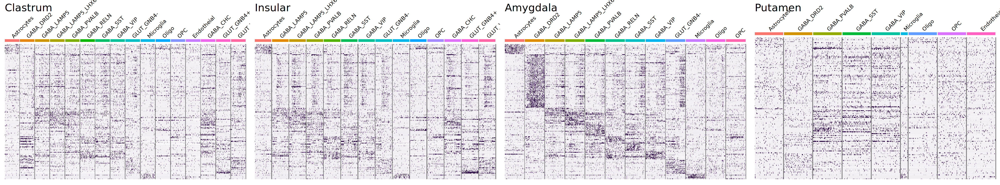

In [57]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="Amygdala")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg4 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4

[1] 266

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



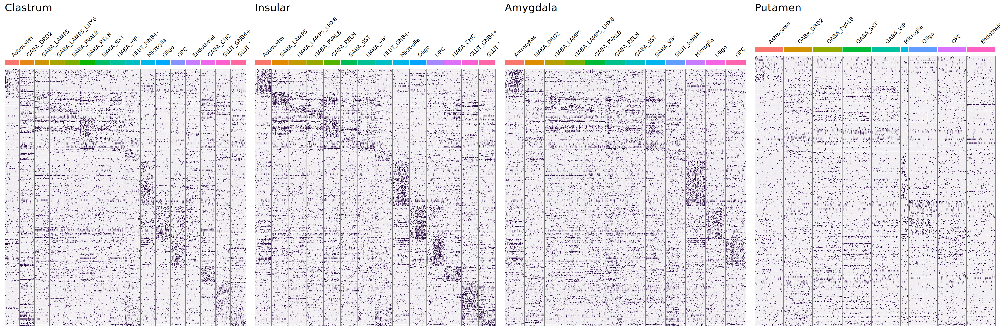

In [58]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="Insular")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg4 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4

[1] 93

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



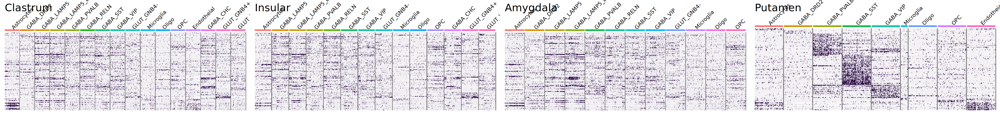

In [59]:
new_order=unique(sub_CLA1_down100@meta.data[order(sub_CLA1_down100$annotSubclass),]$annotSubclass)
new_order=as.character(new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="PU")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/20)
pg4 = plot_grid(
    DoHeatmap(sub_CLA1_down100, features=selectGene) +
        ggtitle("Clastrum") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Insular1_down100, features=selectGene) + 
        ggtitle("Insular") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_Amygdala1_down100, features=selectGene) + 
        ggtitle("Amygdala") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_PU1_down100, features=selectGene) + 
        ggtitle("Putamen") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4

In [88]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat1.pdf", width=40, height=389/20)
pg1
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat2.pdf", width=40, height=123/20)
pg2
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat3.pdf", width=40, height=50/20)
pg3
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/heat4.pdf", width=40, height=139/20)
pg4
dev.off()

png 
  2

png 
  2

png 
  2

png 
  2

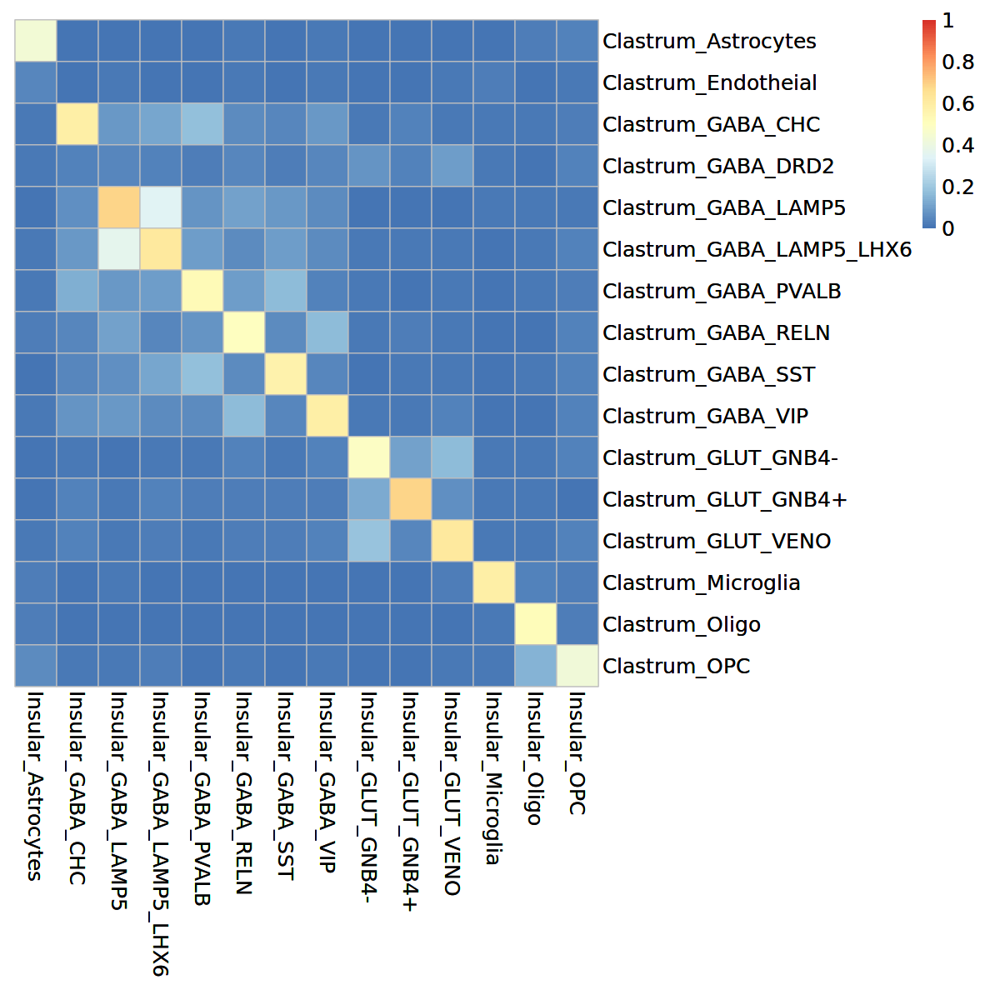

In [89]:


marker1=CLASubclassMarker %>% group_by(cluster) %>% top_n(n=100,wt=avg_log2FC)
marker1$cluster=paste0('Clastrum_',marker1$cluster)
marker2=InsularSubclassMarker %>% group_by(cluster) %>% top_n(n=100,wt=avg_log2FC)
marker2$cluster=paste0('Insular_',marker2$cluster)
marker3=PUSubclassMarker %>% group_by(cluster) %>% top_n(n=100,wt=avg_log2FC)
marker3$cluster=paste0('Putemen_',marker3$cluster)
marker4=AmygdalaSubclassMarker %>% group_by(cluster) %>% top_n(n=100,wt=avg_log2FC)
marker4$cluster=paste0('Amygdala_',marker4$cluster)


df=data.frame()
for(i in unique(marker1$cluster)){select_cluster1=i
for(k in unique(marker2$cluster)){select_cluster2=k
select_gene1=marker1[marker1$cluster==select_cluster1,]$gene
select_gene2=marker2[marker2$cluster==select_cluster2,]$gene
all=c(select_gene1,select_gene2)
all=all[!duplicated(all)]
all_l=length(all)
inter_l=length(intersect(select_gene1,select_gene2))
num=inter_l/all_l
df=rbind(df,c(select_cluster1,select_cluster2,num))}}

colnames(df)=c('cell_type1','cell_type2','value')
df$value=as.numeric(df$value)

df_print=dcast(df,cell_type1~cell_type2)
rownames(df_print)=df_print$cell_type1
df_print$cell_type1=NULL
df_print=as.matrix(df_print)

options(repr.plot.width=10, repr.plot.height=10)
p1=pheatmap(df_print
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color='grey', cellwidth=30, cellheight=30, fontsize=15)

p1

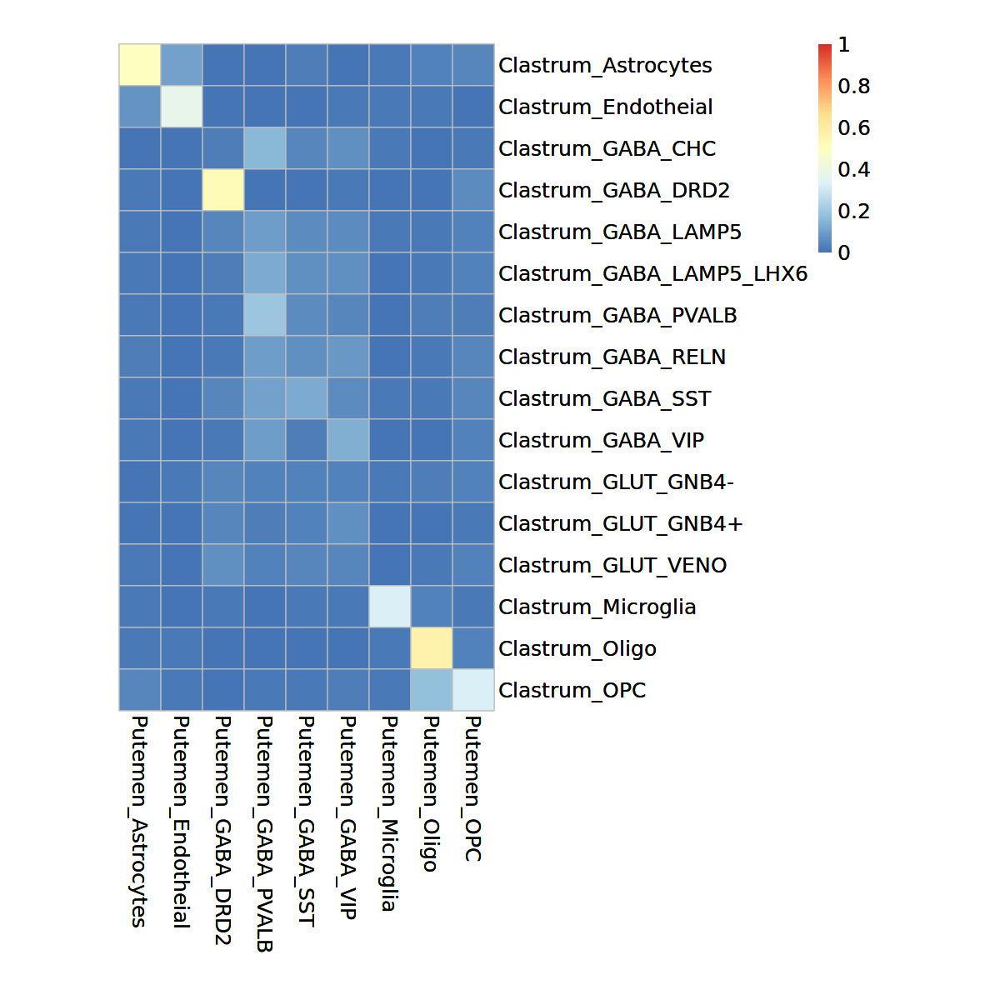

In [90]:
df=data.frame()
for(i in unique(marker1$cluster)){select_cluster1=i
for(k in unique(marker3$cluster)){select_cluster3=k
select_gene1=marker1[marker1$cluster==select_cluster1,]$gene
select_gene3=marker3[marker3$cluster==select_cluster3,]$gene
all=c(select_gene1,select_gene3)
all=all[!duplicated(all)]
all_l=length(all)
inter_l=length(intersect(select_gene1,select_gene3))
num=inter_l/all_l
df=rbind(df,c(select_cluster1,select_cluster3,num))}}
colnames(df)=c('cell_type1','cell_type3','value')
df$value=as.numeric(df$value)

df_print=dcast(df,cell_type1~cell_type3)
rownames(df_print)=df_print$cell_type1
df_print$cell_type1=NULL
df_print=as.matrix(df_print)

options(repr.plot.width=10, repr.plot.height=10)
p2=pheatmap(df_print
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color='grey', cellwidth=30, cellheight=30, fontsize=15)
p2


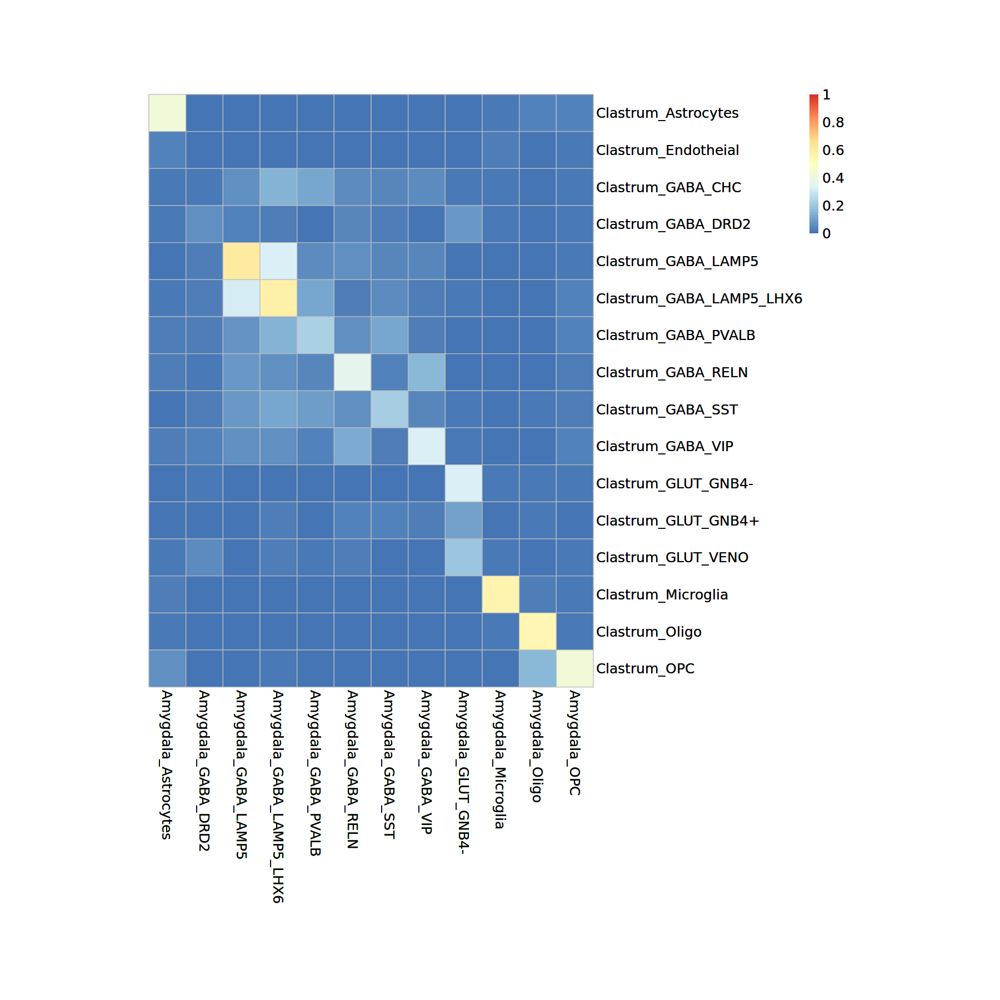

In [93]:
df=data.frame()
for(i in unique(marker1$cluster)){select_cluster1=i
for(k in unique(marker4$cluster)){select_cluster4=k
select_gene1=marker1[marker1$cluster==select_cluster1,]$gene
select_gene4=marker4[marker4$cluster==select_cluster4,]$gene
all=c(select_gene1,select_gene4)
all=all[!duplicated(all)]
all_l=length(all)
inter_l=length(intersect(select_gene1,select_gene4))
num=inter_l/all_l
df=rbind(df,c(select_cluster1,select_cluster4,num))}}
colnames(df)=c('cell_type1','cell_type4','value')
df$value=as.numeric(df$value)

df_print=dcast(df,cell_type1~cell_type4)
rownames(df_print)=df_print$cell_type1
df_print$cell_type1=NULL
df_print=as.matrix(df_print)

options(repr.plot.width=15, repr.plot.height=15)
p3=pheatmap(df_print
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color='grey', cellwidth=40, cellheight=40, fontsize=15)

p3


In [94]:
save_pheatmap_pdf <- function(x, filename, width=15, height=15) {
  stopifnot(!missing(x))
  stopifnot(!missing(filename))
  pdf(filename, width=width, height=height)
  grid::grid.newpage()
  grid::grid.draw(x$gtable)
  dev.off()
}



save_pheatmap_pdf(p1,"/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/jar1.pdf",20,20)
save_pheatmap_pdf(p2,"/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/jar2.pdf",20,20)
save_pheatmap_pdf(p3,"//home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig2_renew_240118/jar3.pdf",20,20)


png 
  2

png 
  2

png 
  2